In [ ]:
import pandas as pd
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import numpy as np

In [ ]:
! cat /proc/cpuinfo .
!df -h

In [ ]:
from google.colab import drive 
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
import glob
import os

def read_dataset():
    uber_directory = 'gdrive/My Drive/Colab Notebooks/IDM dataset'
    file_type = 'csv'
    seperator =','
    dataset = pd.concat([pd.read_csv(f, sep=seperator,parse_dates=   ["Date/Time"]) for f in glob.glob(uber_directory + "/*."+file_type)],ignore_index=True)
    return dataset

In [ ]:
uber_2014_data = read_dataset()
uber_2014_data.head()
uber_2014_data.describe().T
#uber_2014_data.shape()

,count,mean,std,min,25%,50%,75%,max
Lat,1857411.0,40.738578,0.042108,39.6569,40.7198,40.7413,40.7609,41.3476
Lon,1857411.0,-73.971077,0.059755,-74.7737,-73.9960,-73.9829,-73.9621,-72.3359


In [ ]:
uber_2014_data.info()
uber_2014_data.describe().T

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1857411 entries, 0 to 1857410
Data columns (total 4 columns):
 #   Column     Dtype         
---  ------     -----         
 0   Date/Time  datetime64[ns]
 1   Lat        float64       
 2   Lon        float64       
 3   Base       object        
dtypes: datetime64[ns](1), float64(2), object(1)
memory usage: 56.7+ MB


,count,mean,std,min,25%,50%,75%,max
Lat,1857411.0,40.738578,0.042108,39.6569,40.7198,40.7413,40.7609,41.3476
Lon,1857411.0,-73.971077,0.059755,-74.7737,-73.9960,-73.9829,-73.9621,-72.3359


In [ ]:
def divide_date(df):    
    df['date'] = df['Date/Time'].dt.date
    df['month'] = df['Date/Time'].dt.month
    df['week'] = df['Date/Time'].dt.week
    df['MonthDayNum'] = df['Date/Time'].dt.day
    df['HourOfDay'] = df['Date/Time'].dt.hour
    df['DayOfWeekNum'] = df['Date/Time'].dt.dayofweek 
    df['DayOfWeek'] = df['Date/Time'].dt.day_name()
    
    return df

divide_date(uber_2014_data)
uber_2014_data.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated.  Please use Series.dt.isocalendar().week instead.
  after removing the cwd from sys.path.


,Date/Time,Lat,Lon,Base,date,month,week,MonthDayNum,HourOfDay,DayOfWeekNum,DayOfWeek
0,2014-09-01 00:01:00,40.2201,-74.0021,B02512,2014-09-01,9,36,1,0,0,Monday
1,2014-09-01 00:01:00,40.7500,-74.0027,B02512,2014-09-01,9,36,1,0,0,Monday
2,2014-09-01 00:03:00,40.7559,-73.9864,B02512,2014-09-01,9,36,1,0,0,Monday
3,2014-09-01 00:06:00,40.7450,-73.9889,B02512,2014-09-01,9,36,1,0,0,Monday
4,2014-09-01 00:11:00,40.8145,-73.9444,B02512,2014-09-01,9,36,1,0,0,Monday


In [ ]:
len(uber_2014_data[uber_2014_data.duplicated(keep="first")])

39919

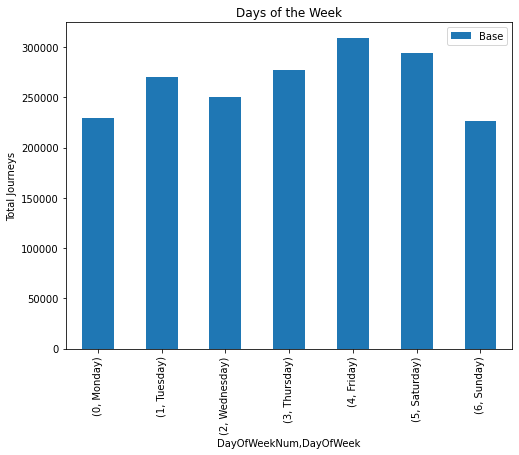

In [ ]:
#create a pivot table of the data
daily_uber_rides = uber_2014_data.pivot_table(index=['DayOfWeekNum', 'DayOfWeek'],
                                  values='Base',
                                  aggfunc='count')
#ploting
daily_uber_rides.plot(kind='bar', figsize=(8,6))
plt.ylabel('Total Journeys')
plt.title('Days of the Week');

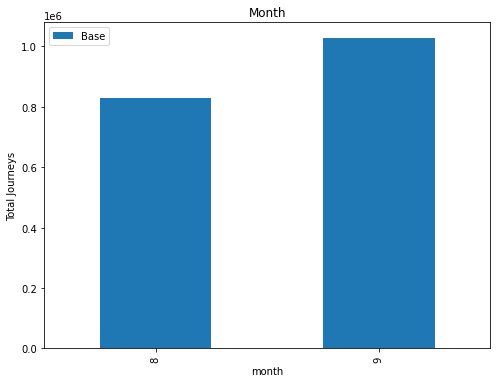

In [ ]:
#create a pivot table of the data
daily_uber_rides = uber_2014_data.pivot_table(index=['month'],
                                  values='Base',
                                  aggfunc='count')
#ploting
daily_uber_rides.plot(kind='bar', figsize=(8,6))
plt.ylabel('Total Journeys')
plt.title('Month');

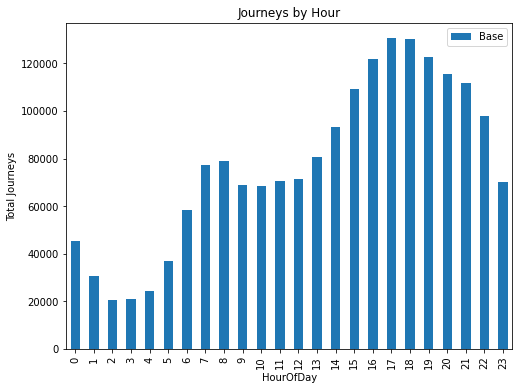

In [ ]:
#create a pivot table of the data
hour = uber_2014_data.pivot_table(index=['HourOfDay'],
                                  values='Base',
                                  aggfunc='count')
hour.plot(kind='bar', figsize=(8,6))
plt.ylabel('Total Journeys')
plt.title('Journeys by Hour');

In [ ]:
# groupby operation
hourly_ride_data = uber_2014_data.groupby(['month','DayOfWeekNum','HourOfDay','DayOfWeek'])['Base'].count()
# reset index
hourly_ride_data = hourly_ride_data.reset_index()
# rename column
hourly_ride_data = hourly_ride_data.rename(columns = {'Base':'RideCount'})
# ocular analysis
hourly_ride_data.head()

,month,DayOfWeekNum,HourOfDay,DayOfWeek,RideCount
0,8,0,0,Monday,1094
1,8,0,1,Monday,684
2,8,0,2,Monday,560
3,8,0,3,Monday,1186
4,8,0,4,Monday,1836


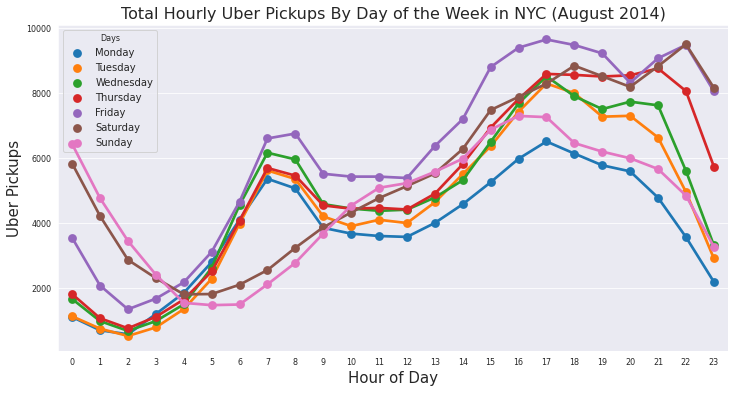

In [ ]:
import seaborn as sns

aug_hourly_data = hourly_ride_data[hourly_ride_data.month == 8]

fig = plt.figure(figsize=(12,6))
sns.set_style('darkgrid')
ax = sns.pointplot(x="HourOfDay", y="RideCount", hue="DayOfWeek", data=aug_hourly_data)
handles,labels = ax.get_legend_handles_labels()
ax.set_xlabel('Hour of Day', fontsize = 15)
ax.set_ylabel('Uber Pickups', fontsize = 15)
ax.set_title('Total Hourly Uber Pickups By Day of the Week in NYC (August 2014)', fontsize=16)
ax.tick_params(labelsize = 8)
ax.legend(handles,labels,loc=0, title="Days", prop={'size':10})
ax.get_legend().get_title().set_fontsize('8')
plt.show()

In [ ]:
base_names = {"Base": {'B02617':'Weiter', 'B02598':'Hinter','B02682':'Schmecken','B02764':'Danach-NY','B02512':'Unter'}}
uber_2014_bases = uber_2014_data.copy()
uber_2014_bases.replace(base_names, inplace=True)
uber_2014_bases.head()

,Date/Time,Lat,Lon,Base,date,month,week,MonthDayNum,HourOfDay,DayOfWeekNum,DayOfWeek
0,2014-09-01 00:01:00,40.2201,-74.0021,Unter,2014-09-01,9,36,1,0,0,Monday
1,2014-09-01 00:01:00,40.7500,-74.0027,Unter,2014-09-01,9,36,1,0,0,Monday
2,2014-09-01 00:03:00,40.7559,-73.9864,Unter,2014-09-01,9,36,1,0,0,Monday
3,2014-09-01 00:06:00,40.7450,-73.9889,Unter,2014-09-01,9,36,1,0,0,Monday
4,2014-09-01 00:11:00,40.8145,-73.9444,Unter,2014-09-01,9,36,1,0,0,Monday


In [ ]:
import plotly.express as px

fig = px.histogram(uber_2014_bases, x="Base",
                  title='Pickups Per Base',
                   labels={'count':'No of Pickups'})
fig.show()

In [ ]:
clus = uber_2014_data[['Lat','Lon']]
print(clus)
clus.dtypes

             Lat      Lon
0        40.2201 -74.0021
1        40.7500 -74.0027
2        40.7559 -73.9864
3        40.7450 -73.9889
4        40.8145 -73.9444
...          ...      ...
1857406  40.7552 -73.9753
1857407  40.7552 -73.9753
1857408  40.7617 -73.9788
1857409  40.7395 -73.9889
1857410  40.7270 -73.9802

[1857411 rows x 2 columns]


Lat    float64
Lon    float64
dtype: object

In [ ]:
uber_2014_data.head()

,Date/Time,Lat,Lon,Base
0,2014-09-01 00:01:00,40.2201,-74.0021,B02512
1,2014-09-01 00:01:00,40.7500,-74.0027,B02512
2,2014-09-01 00:03:00,40.7559,-73.9864,B02512
3,2014-09-01 00:06:00,40.7450,-73.9889,B02512
4,2014-09-01 00:11:00,40.8145,-73.9444,B02512


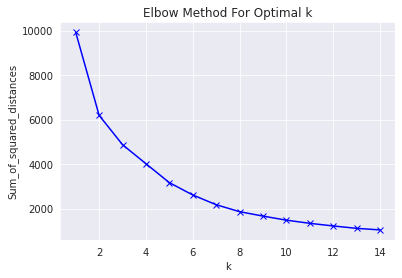

In [ ]:
#creating an elbow plot to find the optimal value of k
Sum_of_squared_distances = []
K = range(1,15)
for k in K:
    km = KMeans(n_clusters=k)
    km = km.fit(clus)
    Sum_of_squared_distances.append(km.inertia_)

plt.plot(K, Sum_of_squared_distances, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

In [ ]:
kmeans = KMeans(n_clusters = 6, max_iter = 300, random_state = 12345 )
identified_clusters = kmeans.fit_predict(clus)
identified_clusters

array([2, 3, 0, ..., 0, 3, 3], dtype=int32)

In [ ]:
df=pd.read_csv('gdrive/My Drive/uber-raw-data-apr14.csv')
df_test = df.sample(n=5)
df_test = df_test[['Lat','Lon']]
print(df_test)

            Lat      Lon
47598   40.7513 -73.9717
313707  40.7422 -73.9949
84855   40.7577 -73.9791
197284  40.7984 -73.9728
39106   40.7244 -73.9936


In [ ]:
# predicting new location
new_loc = np.array(df_test)
cluster = kmeans.predict(df_test)
print(cluster)

[0 3 0 0 3]


In [ ]:
#assigning clusters to our test data set
clusters_df = pd.DataFrame(cluster, columns=["Cluster"])
#print(clusters_df)
df_test.reset_index(drop=True, inplace=True)
prediction = df_test.join(clusters_df)
print(prediction)

       Lat      Lon  Cluster
0  40.7513 -73.9717        0
1  40.7422 -73.9949        3
2  40.7577 -73.9791        0
3  40.7984 -73.9728        0
4  40.7244 -73.9936        3


In [ ]:
identified_clusters_df = pd.DataFrame(identified_clusters, columns=["Cluster"])

result = uber_2014_data.join(identified_clusters_df)
print(result.head())

            Date/Time      Lat      Lon  ... DayOfWeekNum DayOfWeek  Cluster
0 2014-09-01 00:01:00  40.2201 -74.0021  ...            0    Monday        2
1 2014-09-01 00:01:00  40.7500 -74.0027  ...            0    Monday        3
2 2014-09-01 00:03:00  40.7559 -73.9864  ...            0    Monday        0
3 2014-09-01 00:06:00  40.7450 -73.9889  ...            0    Monday        3
4 2014-09-01 00:11:00  40.8145 -73.9444  ...            0    Monday        0

[5 rows x 12 columns]


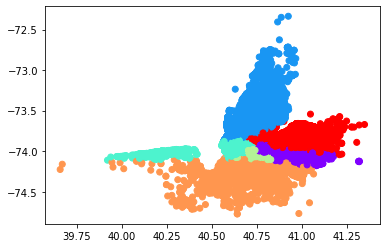

In [ ]:
data_with_clusters = uber_2014_data.copy()
data_with_clusters['Clusters'] = identified_clusters 
data_with_clusters.head()
plt.scatter(data_with_clusters['Lat'],data_with_clusters['Lon'],c=data_with_clusters['Clusters'],cmap='rainbow')

In [ ]:
centeroids = kmeans.cluster_centers_
print(centeroids)

clocation = pd.DataFrame(centeroids, columns=['Latitude', 
                      'Longitude'])
clocation.head()

[[ 40.76775634 -73.97116508]
 [ 40.66794799 -73.75895111]
 [ 40.68721758 -73.96332532]
 [ 40.73163617 -73.99764096]
 [ 40.6985278  -74.20241477]
 [ 40.79698821 -73.87362888]]


,Latitude,Longitude
0,40.767756,-73.971165
1,40.667948,-73.758951
2,40.687218,-73.963325
3,40.731636,-73.997641
4,40.698528,-74.202415


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: MatplotlibDeprecationWarning: Support for uppercase single-letter colors is deprecated since Matplotlib 3.1 and will be removed in 3.3; please use lowercase instead.
  """Entry point for launching an IPython kernel.


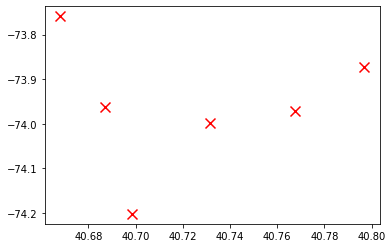

In [ ]:
plt.scatter(clocation['Latitude'], clocation['Longitude'], marker = "x", color = "R", s = 100)
plt.show()

In [ ]:
import folium
# Converting centroid into lists
centroid = clocation.values.tolist()
# Plotting the centroids on google map using Folium library.
map = folium.Map(location=[40.68757394, -73.96432287], zoom_start = 25)
for point in range(0, len(centroid)):
    folium.Marker(centroid[point], popup = str(centroid[point])).add_to(map)
map